# Porto Taxi Trajectory: Data Exploration and Hotspot Analysis

This notebook presents a comprehensive analysis of the Porto taxi trip dataset. The workflow encompasses data loading and sampling, preprocessing and cleaning, exploratory temporal analysis, and geospatial hotspot identification using HDBSCAN clustering. The final clustered data is prepared for further GIS analysis.

In [13]:
# Core data manipulation and numerical operations
import pandas as pd
import numpy as np
import ast  # For safely evaluating string-formatted lists

# Filesystem and path management
from pathlib import Path

# Date and time operations (though pandas handles most)
import datetime

# Geospatial data processing
import geopandas as gpd
from geopy.distance import geodesic # For distance calculation

# Clustering algorithm
import hdbscan

# Visualization
import matplotlib.pyplot as plt
import matplotlib.colors
import seaborn as sns

# Interactive maps
import folium
from folium.plugins import HeatMapWithTime # For animated temporal-spatial heatmap

# Random sampling for data loading
import random

# To display outputs directly in the notebook
from IPython.display import display

## 1. Configuration and Project Setup

Define project paths and global settings for data loading and display.

In [14]:
# Define project paths
# Assumes the notebook is in a subdirectory of the main project folder
project_dir = Path().resolve()
data_dir = project_dir / "data"
raw_data_dir = data_dir / "raw"
processed_data_dir = data_dir / "processed"
raw_data_file = raw_data_dir / "train.csv"  # Main dataset

# Ensure processed data directory exists
processed_data_dir.mkdir(parents=True, exist_ok=True)

# Sampling percentage for initial data loading
DATA_SAMPLE_PERCENTAGE = 2

# Pandas display options for better readability
pd.set_option('display.max_columns', None)
pd.set_option('display.float_format', lambda x: f'{x:.5f}')

print(f"Project Directory: {project_dir}")
print(f"Raw Data File: {raw_data_file}")
print(f"Processed Data Directory: {processed_data_dir}")

Project Directory: S:\GIS\porto-taxi-clustering
Raw Data File: S:\GIS\porto-taxi-clustering\data\raw\train.csv
Processed Data Directory: S:\GIS\porto-taxi-clustering\data\processed


## 2. Data Loading and Initial Inspection

Load a sample of the dataset to facilitate efficient exploration. The `POLYLINE` column, containing trip coordinates, will be parsed, and an initial `trip_duration` will be estimated.

In [15]:
def load_sample_data(file_path: Path, sample_fraction: float, random_state: int = 42) -> pd.DataFrame:
    """
    Loads a random sample of the data from a CSV file.
    Parses POLYLINE strings into lists of coordinates and estimates trip duration.
    """
    if not file_path.exists():
        raise FileNotFoundError(f"Raw data file not found: {file_path}")

    # Get total number of rows for sampling (excluding header)
    with open(file_path, 'r', encoding='utf-8') as f:
        n_total_rows = sum(1 for _ in f) - 1
    
    sample_size = int(n_total_rows * sample_fraction)
    if sample_size == 0 and n_total_rows > 0 : # ensure at least one row if data exists and fraction is very small
        sample_size = 1
        
    # Rows to skip (0-indexed for skiprows, but 1-indexed for range)
    # random.sample requires population size to be >= sample size
    if n_total_rows > sample_size :
        skip_rows = sorted(random.sample(range(1, n_total_rows + 1), n_total_rows - sample_size))
    elif n_total_rows > 0 and n_total_rows == sample_size: # sampling all rows
        skip_rows = None
    else: # no rows to sample or empty file
        return pd.DataFrame()


    df = pd.read_csv(
        file_path,
        skiprows=skip_rows,
        parse_dates=['TIMESTAMP'],
        date_parser=lambda x: pd.to_datetime(int(x), unit='s') # Assuming TIMESTAMP is Unix epoch
    )

    # Safely parse POLYLINE from string to list of lists
    df['POLYLINE'] = df['POLYLINE'].apply(
        lambda x: ast.literal_eval(x) if isinstance(x, str) and x.startswith('[') else []
    )

    # Extract start and end coordinates
    df['start_lon'] = df['POLYLINE'].apply(lambda x: x[0][0] if len(x) > 0 else np.nan)
    df['start_lat'] = df['POLYLINE'].apply(lambda x: x[0][1] if len(x) > 0 else np.nan)
    df['end_lon'] = df['POLYLINE'].apply(lambda x: x[-1][0] if len(x) > 1 else np.nan) # Needs at least 2 points for distinct end
    df['end_lat'] = df['POLYLINE'].apply(lambda x: x[-1][1] if len(x) > 1 else np.nan)

    # Estimate trip duration: 15 seconds per polyline point (as per original notebook assumption)
    df['trip_duration_estimated_sec'] = df['POLYLINE'].apply(lambda x: (len(x) -1) * 15 if len(x) > 0 else 0)
    
    return df

# Load sample data
print(f"Loading {DATA_SAMPLE_PERCENTAGE}% sample of the data...")
df_sample = load_sample_data(raw_data_file, sample_fraction=DATA_SAMPLE_PERCENTAGE / 100)

print(f"Loaded sample data with shape: {df_sample.shape}")

Loading 2% sample of the data...


C:\Users\Pc\AppData\Local\Temp\ipykernel_3536\1888109432.py:27: FutureWarning: The argument 'date_parser' is deprecated and will be removed in a future version. Please use 'date_format' instead, or read your data in as 'object' dtype and then call 'to_datetime'.
  df = pd.read_csv(


Loaded sample data with shape: (34213, 14)


## 3. Data Preprocessing and Cleaning

A function is defined to clean the taxi trip data by removing invalid entries, calculating trip metrics, and filtering unrealistic trips.

In [16]:
def clean_taxi_data(df: pd.DataFrame) -> tuple[pd.DataFrame, dict]:
    """
    Cleans and preprocesses the taxi trip DataFrame.
    - Removes trips with missing or invalid polylines/coordinates.
    - Calculates trip distance and average speed.
    - Filters out unrealistic trips based on speed, distance, and duration.
    Returns a cleaned DataFrame and a report of cleaning actions.
    """
    df_clean = df.copy()
    report = {}
    initial_rows = len(df_clean)

    # 1. Handle POLYLINE and essential coordinate issues
    df_clean = df_clean[df_clean['POLYLINE'].apply(lambda x: isinstance(x, list) and len(x) >= 2)] # Need at least start and end
    report['removed_short_polyline'] = initial_rows - len(df_clean)
    current_rows = len(df_clean)

    df_clean = df_clean.dropna(subset=['start_lon', 'start_lat', 'end_lon', 'end_lat'])
    report['removed_missing_coords'] = current_rows - len(df_clean)
    current_rows = len(df_clean)

    # 2. Create coordinate tuples for geopy
    df_clean['start_coord'] = list(zip(df_clean['start_lat'], df_clean['start_lon']))
    df_clean['end_coord'] = list(zip(df_clean['end_lat'], df_clean['end_lon']))

    # 3. Filter out invalid geographic coordinates
    def is_valid_coord(coord_tuple):
        lat, lon = coord_tuple
        return -90 <= lat <= 90 and -180 <= lon <= 180
    
    valid_start = df_clean['start_coord'].apply(is_valid_coord)
    valid_end = df_clean['end_coord'].apply(is_valid_coord)
    df_clean = df_clean[valid_start & valid_end]
    report['removed_invalid_coords'] = current_rows - len(df_clean)
    current_rows = len(df_clean)

    # 4. Calculate trip metrics
    df_clean['trip_distance_km'] = df_clean.apply(
        lambda row: geodesic(row['start_coord'], row['end_coord']).km if row['start_coord'] != row['end_coord'] else 0, axis=1
    )
    # Use 'trip_duration_estimated_sec' from loading, convert to minutes
    df_clean['trip_duration_min'] = df_clean['trip_duration_estimated_sec'] / 60.0
    
    # Avoid division by zero for speed; add small epsilon or handle zero duration
    df_clean['avg_speed_kmh'] = df_clean['trip_distance_km'] / (df_clean['trip_duration_min'] / 60 + 1e-6) # duration in hours

    # 5. Filter unrealistic trips
    # Speed: 0 < speed <= 120 km/h
    # Distance: >= 100m
    # Duration: >= 1 minute
    speed_mask = (df_clean['avg_speed_kmh'] > 0) & (df_clean['avg_speed_kmh'] <= 120)
    distance_mask = df_clean['trip_distance_km'] >= 0.1  # 100m
    duration_mask = df_clean['trip_duration_min'] >= 1   # 1 minute
    
    df_clean = df_clean[speed_mask & distance_mask & duration_mask]
    report['removed_unrealistic_trips'] = current_rows - len(df_clean)

    # Final summary for report
    report['final_rows'] = len(df_clean)
    report['total_rows_removed'] = initial_rows - len(df_clean)
    if initial_rows > 0:
        report['percentage_removed'] = (report['total_rows_removed'] / initial_rows) * 100
    else:
        report['percentage_removed'] = 0
        
    return df_clean, report

# Apply cleaning function
print("\nCleaning data...")
df_clean, cleaning_report = clean_taxi_data(df_sample)

print("\nData Cleaning Report:")
for key, value in cleaning_report.items():
    if isinstance(value, float):
        print(f"  - {key.replace('_', ' ').capitalize()}: {value:.2f}%")
    else:
        print(f"  - {key.replace('_', ' ').capitalize()}: {value}")

print(f"\nCleaned data shape: {df_clean.shape}")


Cleaning data...

Data Cleaning Report:
  - Removed short polyline: 761
  - Removed missing coords: 0
  - Removed invalid coords: 0
  - Removed unrealistic trips: 809
  - Final rows: 32643
  - Total rows removed: 1570
  - Percentage removed: 4.59%

Cleaned data shape: (32643, 19)


In [17]:
print("\nCleaned Data Information:")
df_clean.info()

print("\nCleaned Data Head:")
display(df_clean.head())


Cleaned Data Information:
<class 'pandas.core.frame.DataFrame'>
Index: 32643 entries, 0 to 34212
Data columns (total 19 columns):
 #   Column                       Non-Null Count  Dtype         
---  ------                       --------------  -----         
 0   TRIP_ID                      32643 non-null  int64         
 1   CALL_TYPE                    32643 non-null  object        
 2   ORIGIN_CALL                  7042 non-null   float64       
 3   ORIGIN_STAND                 15690 non-null  float64       
 4   TAXI_ID                      32643 non-null  int64         
 5   TIMESTAMP                    32643 non-null  datetime64[ns]
 6   DAY_TYPE                     32643 non-null  object        
 7   MISSING_DATA                 32643 non-null  bool          
 8   POLYLINE                     32643 non-null  object        
 9   start_lon                    32643 non-null  float64       
 10  start_lat                    32643 non-null  float64       
 11  end_lon            

,TRIP_ID,CALL_TYPE,ORIGIN_CALL,ORIGIN_STAND,TAXI_ID,TIMESTAMP,DAY_TYPE,MISSING_DATA,POLYLINE,start_lon,start_lat,end_lon,end_lat,trip_duration_estimated_sec,start_coord,end_coord,trip_distance_km,trip_duration_min,avg_speed_kmh
0,1372639960620000309,B,NaN,38.00000,20000309,2013-07-01 00:52:40,A,False,"[[-8.60418, 41.160969], [-8.603874, 41.1615], ...",-8.60418,41.16097,-8.57976,41.16790,285,"(41.160969, -8.60418)","(41.167899, -8.579763)",2.18897,4.75000,27.64984
1,1372642990620000503,B,NaN,47.00000,20000503,2013-07-01 01:43:10,A,False,"[[-8.654778, 41.173533], [-8.654418, 41.173866...",-8.65478,41.17353,-8.64579,41.18054,120,"(41.173533, -8.654778)","(41.180544, -8.645787)",1.08417,2.00000,32.52407
2,1372646173620000686,B,NaN,23.00000,20000686,2013-07-01 02:36:13,A,False,"[[-8.612496, 41.145975], [-8.611794, 41.145993...",-8.61250,41.14597,-8.59718,41.18241,555,"(41.145975, -8.612496)","(41.182407, -8.597178)",4.24536,9.25000,27.53729
3,1372649921620000367,A,21482.00000,NaN,20000367,2013-07-01 03:38:41,A,False,"[[-8.612235, 41.147082], [-8.612145, 41.147514...",-8.61224,41.14708,-8.67027,41.23764,990,"(41.147082, -8.612235)","(41.23764, -8.670267)",11.17349,16.50000,40.63072
4,1372651034620000403,C,NaN,NaN,20000403,2013-07-01 03:57:14,A,False,"[[-8.615736, 41.147289], [-8.615781, 41.147298...",-8.61574,41.14729,-8.67025,41.23741,945,"(41.147289, -8.615736)","(41.237415, -8.670249)",11.00440,15.75000,41.92138


## 4. Feature Engineering for Temporal Analysis

Extract temporal features such as hour, day of the week, and month from the `TIMESTAMP` to facilitate pattern analysis.

In [18]:
if not df_clean.empty and 'TIMESTAMP' in df_clean.columns:
    df_clean['hour'] = df_clean['TIMESTAMP'].dt.hour
    df_clean['day_of_week'] = df_clean['TIMESTAMP'].dt.dayofweek  # Monday=0, Sunday=6
    df_clean['day_name'] = df_clean['TIMESTAMP'].dt.day_name()
    df_clean['month'] = df_clean['TIMESTAMP'].dt.month
    df_clean['is_weekend'] = df_clean['day_of_week'].isin([5, 6]) # Saturday, Sunday
    print("Temporal features engineered.")
    display(df_clean[['TIMESTAMP', 'hour', 'day_name', 'month', 'is_weekend']].head())
else:
    print("Cleaned data is empty or 'TIMESTAMP' column missing. Skipping temporal feature engineering.")

Temporal features engineered.


,TIMESTAMP,hour,day_name,month,is_weekend
0,2013-07-01 00:52:40,0,Monday,7,False
1,2013-07-01 01:43:10,1,Monday,7,False
2,2013-07-01 02:36:13,2,Monday,7,False
3,2013-07-01 03:38:41,3,Monday,7,False
4,2013-07-01 03:57:14,3,Monday,7,False


## 5. Exploratory Temporal Analysis

Visualize trip patterns across different time scales: hourly, daily, and monthly distributions, and compare weekday versus weekend activity. An animated heatmap shows spatial trip density over 24 hours.

C:\Users\Pc\AppData\Local\Temp\ipykernel_3536\954841599.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='hour', data=df, ax=axes[0, 0], palette='viridis')
C:\Users\Pc\AppData\Local\Temp\ipykernel_3536\954841599.py:18: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='day_name', data=df, order=day_order, ax=axes[0, 1], palette='viridis')
C:\Users\Pc\AppData\Local\Temp\ipykernel_3536\954841599.py:25: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='month', data=df, ax=axes[1, 0], palette='viridis')


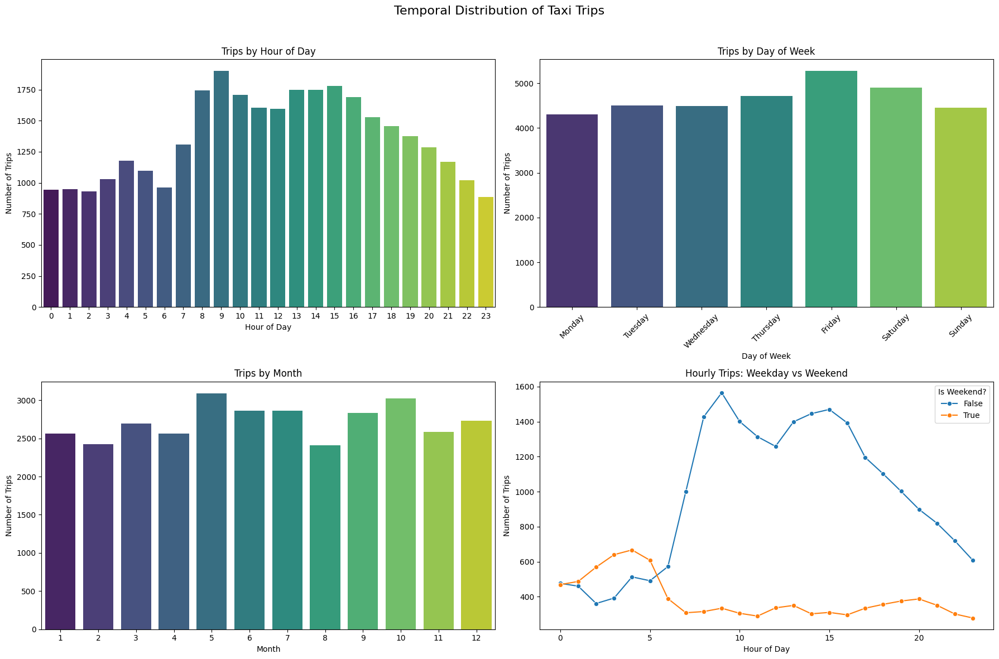

In [19]:
def plot_temporal_distributions(df: pd.DataFrame):
    """Generates and displays plots for temporal trip distributions."""
    if df.empty or not all(col in df.columns for col in ['hour', 'day_name', 'month', 'is_weekend']):
        print("Required temporal columns missing or DataFrame is empty. Skipping temporal plots.")
        return

    fig, axes = plt.subplots(2, 2, figsize=(18, 12))
    fig.suptitle('Temporal Distribution of Taxi Trips', fontsize=16)

    # Hourly distribution
    sns.countplot(x='hour', data=df, ax=axes[0, 0], palette='viridis')
    axes[0, 0].set_title('Trips by Hour of Day')
    axes[0, 0].set_xlabel('Hour of Day')
    axes[0, 0].set_ylabel('Number of Trips')

    # Daily distribution
    day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
    sns.countplot(x='day_name', data=df, order=day_order, ax=axes[0, 1], palette='viridis')
    axes[0, 1].set_title('Trips by Day of Week')
    axes[0, 1].set_xlabel('Day of Week')
    axes[0, 1].set_ylabel('Number of Trips')
    axes[0, 1].tick_params(axis='x', rotation=45)

    # Monthly distribution
    sns.countplot(x='month', data=df, ax=axes[1, 0], palette='viridis')
    axes[1, 0].set_title('Trips by Month')
    axes[1, 0].set_xlabel('Month')
    axes[1, 0].set_ylabel('Number of Trips')

    # Weekday vs Weekend (hourly)
    sns.lineplot(x='hour', y='TRIP_ID', data=df.groupby(['hour', 'is_weekend'])['TRIP_ID'].count().reset_index(), 
                 hue='is_weekend', ax=axes[1, 1], marker='o')
    axes[1, 1].set_title('Hourly Trips: Weekday vs Weekend')
    axes[1, 1].set_xlabel('Hour of Day')
    axes[1, 1].set_ylabel('Number of Trips')
    axes[1, 1].legend(title='Is Weekend?')
    
    plt.tight_layout(rect=[0, 0, 1, 0.96]) # Adjust layout to make space for suptitle
    plt.show()

if not df_clean.empty:
    plot_temporal_distributions(df_clean)

In [20]:
def create_animated_heatmap(df: pd.DataFrame, lat_col: str = 'start_lat', lon_col: str = 'start_lon'):
    """Creates and displays an animated Folium heatmap of trip start locations over 24 hours."""
    if df.empty or not all(col in df.columns for col in [lat_col, lon_col, 'hour']):
        print("Required columns for animated heatmap missing or DataFrame empty.")
        return None

    # Prepare data for HeatMapWithTime: list of lists of [lat, lon] for each hour
    heat_data_hourly = []
    for h in range(24):
        hourly_coords = df[df['hour'] == h][[lat_col, lon_col]].dropna().values.tolist()
        heat_data_hourly.append(hourly_coords)

    if not any(heat_data_hourly): # Check if there's any data to plot
        print("No valid coordinate data found to generate animated heatmap.")
        return None

    # Create base map centered on Porto (approximate)
    map_center_porto = [df[lat_col].mean(), df[lon_col].mean()]
    animated_map = folium.Map(location=map_center_porto, zoom_start=12, tiles="cartodbpositron")

    HeatMapWithTime(
        heat_data_hourly,
        index=[f"{h:02d}:00" for h in range(24)],
        auto_play=True,
        radius=10, # Adjust radius for visual preference
        gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'},
        min_opacity=0.3,
        max_opacity=0.7,
        use_local_extrema=True
    ).add_to(animated_map)
    
    print("Animated temporal-spatial heatmap created (displayed below if in Jupyter).")
    return animated_map

if not df_clean.empty:
    animated_heatmap_folium = create_animated_heatmap(df_clean)
    if animated_heatmap_folium:
        display(animated_heatmap_folium)
        # animated_heatmap_folium.save(processed_data_dir / "animated_pickup_heatmap.html")
        # print(f"Animated heatmap saved to: {processed_data_dir / 'animated_pickup_heatmap.html'}")

Animated temporal-spatial heatmap created (displayed below if in Jupyter).


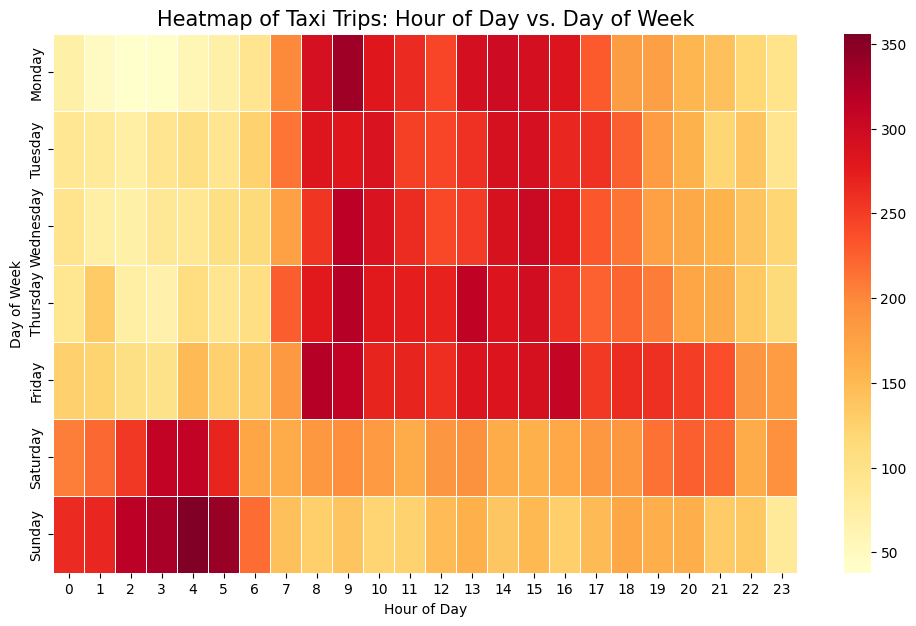

In [21]:
if not df_clean.empty and all(col in df_clean.columns for col in ['hour', 'day_name', 'TRIP_ID']):
    plt.figure(figsize=(12, 7))
    hour_day_pivot = df_clean.pivot_table(
        index='day_name', columns='hour', values='TRIP_ID', aggfunc='count', fill_value=0
    )
    day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
    hour_day_pivot = hour_day_pivot.reindex(day_order) # Ensure correct day order

    sns.heatmap(hour_day_pivot, cmap="YlOrRd", linewidths=.5)
    plt.title('Heatmap of Taxi Trips: Hour of Day vs. Day of Week', fontsize=15)
    plt.xlabel('Hour of Day')
    plt.ylabel('Day of Week')
    plt.show()
else:
    print("Skipping static heatmap due to missing columns or empty DataFrame.")

## Key Insights from Temporal Analysis:

*   **Peak Hours:** Taxi demand significantly peaks during morning (around 8-10 AM) and late afternoon/evening (around 3-6 PM). There's also a noticeable surge late at night, particularly around midnight.
*   **Busiest Days:** Fridays and Saturdays show the highest taxi trip volumes, indicating increased activity during weekends. Mid-week days (Tuesday-Thursday) are relatively stable.
*   **Monthly Trends:** Trip counts show some fluctuation across months, with potential peaks in spring (e.g., March, May) and later in the year (e.g., October, December). August appears to have a relative dip.
*   **Weekday vs. Weekend:**
    *   **Weekdays:** Exhibit distinct morning and afternoon/evening peaks, likely corresponding to commute times and daily business.
    *   **Weekends:** Show a different pattern, with activity building up later in the day and peaking late at night. Early morning weekend hours (e.g., 2-5 AM) also show notable activity compared to weekdays.
*   **Combined Patterns (Heatmap):**
    *   Weekday mornings (especially 8-9 AM) are consistently busy.
    *   Friday and Saturday evenings/nights (from afternoon through past midnight) are major hotspots for taxi demand.
    *   Early morning hours on weekends (especially Saturday and Sunday around 1-4 AM) show higher activity than weekday equivalents.
    *   Sunday afternoons also show a moderate level of activity.

## 6. Geospatial Hotspot Identification using HDBSCAN

Identify dense clusters of taxi pickup locations using the HDBSCAN algorithm. This method is suitable for discovering clusters of varying shapes and densities and is robust to noise.

In [22]:
if not df_clean.empty and all(col in df_clean.columns for col in ['start_lon', 'start_lat']):
    # Convert pickup coordinates to a GeoDataFrame
    gdf_pickups = gpd.GeoDataFrame(
        df_clean.copy(), # Use a copy to avoid modifying df_clean directly
        geometry=gpd.points_from_xy(df_clean.start_lon, df_clean.start_lat),
        crs="EPSG:4326"  # WGS84 geographic CRS
    )

    # Project to a local CRS (e.g., EPSG:3763 for Portugal) for accurate distance calculations
    gdf_pickups_proj = gdf_pickups.to_crs("EPSG:3763")
    print(f"GeoDataFrame created and projected. Shape: {gdf_pickups_proj.shape}")
else:
    print("Skipping HDBSCAN preparation due to missing columns or empty DataFrame.")
    gdf_pickups_proj = gpd.GeoDataFrame() # Empty GDF to prevent later errors

GeoDataFrame created and projected. Shape: (32643, 25)


In [23]:
if not gdf_pickups_proj.empty:
    # Extract (x, y) coordinates in the projected CRS
    coordinates = np.array(
        list(gdf_pickups_proj.geometry.apply(lambda point: (point.x, point.y)))
    )

    # Initialize and apply the HDBSCAN algorithm
    clusterer = hdbscan.HDBSCAN(
        min_cluster_size=75,    # Minimum points to form a cluster
        min_samples=15,         # Influences noise detection; points in denser regions
        metric='euclidean',
        prediction_data=True    # Allows access to cluster probabilities if needed
    )
    cluster_labels = clusterer.fit_predict(coordinates)

    # Integrate cluster labels back into GeoDataFrames
    gdf_pickups_proj['cluster_id'] = cluster_labels
    gdf_pickups['cluster_id'] = cluster_labels # For WGS84 visualization

    # Report clustering summary
    num_identified_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
    num_noise_points = np.count_nonzero(cluster_labels == -1)
    print(f"\nHDBSCAN Clustering Results:")
    print(f"  - Identified Clusters: {num_identified_clusters}")
    print(f"  - Noise Points: {num_noise_points} (out of {len(gdf_pickups_proj)} total points)")
    if num_identified_clusters > 0:
        print(f"  - Cluster Distribution (excluding noise):\n{pd.Series(cluster_labels[cluster_labels != -1]).value_counts().sort_index().to_string()}")
else:
    print("Skipping HDBSCAN clustering as projected GeoDataFrame is empty.")


HDBSCAN Clustering Results:
  - Identified Clusters: 92
  - Noise Points: 6898 (out of 32643 total points)
  - Cluster Distribution (excluding noise):
0       77
1      160
2     1942
3      119
4      211
5      189
6      275
7       98
8      465
9      276
10     320
11     925
12      88
13     185
14     219
15     232
16     432
17     114
18      94
19     107
20     167
21      88
22      81
23     231
24     197
25     311
26     137
27     161
28     139
29     286
30     125
31     167
32     144
33     295
34     195
35     316
36      86
37     113
38     230
39     180
40     158
41     678
42     420
43     117
44     316
45     115
46      87
47      78
48     101
49     396
50     550
51     455
52     197
53      93
54     287
55     239
56     393
57     228
58     601
59      83
60      97
61     276
62     662
63     127
64     128
65     245
66     179
67     497
68     127
69     459
70     510
71     553
72     250
73     421
74     100
75     183
76     740
7

In [24]:
if not gdf_pickups.empty and 'cluster_id' in gdf_pickups.columns:
    # Center map on Porto (approximate mean of coordinates)
    map_center_porto = [gdf_pickups['start_lat'].mean(), gdf_pickups['start_lon'].mean()]
    hotspot_map_hdbscan = folium.Map(location=map_center_porto, zoom_start=12, tiles="cartodbpositron")

    # Define a color palette for clusters
    valid_cluster_labels = sorted([lbl for lbl in gdf_pickups['cluster_id'].unique() if lbl != -1])
    if valid_cluster_labels:
        cmap = plt.cm.get_cmap('viridis', len(valid_cluster_labels))
        cluster_colors = {label: matplotlib.colors.rgb2hex(cmap(i)) for i, label in enumerate(valid_cluster_labels)}
    else:
        cluster_colors = {}

    # Filter out noise for visualization and sample if necessary for performance
    gdf_display_clusters = gdf_pickups[gdf_pickups['cluster_id'] != -1]
    
    # Limit points on map for responsiveness if dataset is large
    sample_n_clusters = min(len(gdf_display_clusters), 20000) 

    for idx, row in gdf_display_clusters.sample(n=sample_n_clusters, random_state=42).iterrows():
        folium.CircleMarker(
            location=[row['start_lat'], row['start_lon']],
            radius=2.5,
            color=cluster_colors.get(row['cluster_id'], '#808080'), # Default for safety
            fill=True,
            fill_color=cluster_colors.get(row['cluster_id'], '#808080'),
            fill_opacity=0.7,
            tooltip=f"Cluster ID: {row['cluster_id']}"
        ).add_to(hotspot_map_hdbscan)

    output_map_file_hdbscan = processed_data_dir / "porto_pickup_hotspots_hdbscan.html"
    hotspot_map_hdbscan.save(output_map_file_hdbscan)
    print(f"\nInteractive HDBSCAN hotspot map saved as: {output_map_file_hdbscan}")
    display(hotspot_map_hdbscan) # Display map in notebook
else:
    print("Skipping HDBSCAN map visualization as clustered data is not available.")

C:\Users\Pc\AppData\Local\Temp\ipykernel_3536\1508879229.py:9: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('viridis', len(valid_cluster_labels))



Interactive HDBSCAN hotspot map saved as: S:\GIS\porto-taxi-clustering\data\processed\porto_pickup_hotspots_hdbscan.html


## 7. Data Export for GIS Analysis

The GeoDataFrame containing pickup locations and their assigned HDBSCAN cluster IDs is exported to GeoPackage format. This allows for advanced spatial analysis and cartographic map production in GIS software like QGIS.

In [25]:
if not gdf_pickups.empty and 'cluster_id' in gdf_pickups.columns:
    output_geopackage_path = processed_data_dir / "porto_hdbscan_pickups.gpkg"
    try:
        gdf_pickups.to_file(output_geopackage_path, driver="GPKG", layer="pickup_hotspots_hdbscan")
        print(f"\nClustered pickup data exported to GeoPackage: {output_geopackage_path}")
    except Exception as e:
        print(f"Error during GeoPackage export: {e}")
else:
    print("Skipping data export as clustered GeoDataFrame is not available.")



Clustered pickup data exported to GeoPackage: S:\GIS\porto-taxi-clustering\data\processed\porto_hdbscan_pickups.gpkg


## 8. Conclusion and Further Steps

This notebook demonstrated a workflow for analyzing taxi trip data, including loading, cleaning, temporal pattern visualization, and geospatial hotspot identification using HDBSCAN.

**Key findings include:**
- Identification of temporal trends in taxi usage (hourly, daily, monthly).
- Successful application of HDBSCAN to identify dense clusters of taxi pickup locations.

**Further steps could involve:**
- In-depth analysis of trip characteristics (duration, distance, speed) originating from or terminating in identified hotspots.
- Spatial join with other datasets (e.g., points of interest, administrative boundaries) to enrich hotspot context.
- Advanced visualization and cartographic map production in QGIS using the exported GeoPackage.
- Predictive modeling of taxi demand based on temporal and spatial features.